In [2]:
import numpy as np

def indices_above_percentile(arr: np.ndarray, percentile: float) -> np.ndarray:
    """
    Returns 1-based indices of elements in arr that are >= the given percentile value.

    Parameters:
        arr (np.ndarray): Input array.
        percentile (float): Percentile value between 0 and 100.

    Returns:
        np.ndarray: 1-based indices of elements >= percentile value.
    """
    threshold = np.percentile(arr, percentile)
    zero_based_indices = np.where(arr >= threshold)[0]
    one_based_indices = zero_based_indices + 1
    return one_based_indices


In [3]:
## Load the FLDMEAN data
import xarray as xr
ds = xr.open_dataset("/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/PLTDATA/FM03_RandomSamples/CO1_SM_FLDMEAN_2001-2023.nc").prec.data.squeeze()

indices = indices_above_percentile(ds, 99)
print(indices)

[ 152  154  155  156  503  566  567  568  588  886  891  940 1234 1235
 1283 1284 1285 1286 1287 1351 1352 1375 1376 1976 2025 2325 2353 2391
 2392 2393 2397 2398 2438 2440 3103 3567 3568 3851 3852 4193 4194 4222
 4591 4599 4973 4974 5289 5320 5324 5344 5345 5620 5640 5684 5711 5994
 6007 6034 6048 6066 6067 6137 6138 6358 6370 6371 6372 6373 6763 6764
 6765 6766 7108 7169 7486 7836 7837 7838 7967 8169 8200 8253 8254 8268]


## CDO Code

In [4]:
"""
#!/bin/bash

SOURCEPATH="/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/GENDATA/TESTING/MASTER"
DESTINPATH="/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/PLTDATA/FM03_RandomSamples"
mkdir -p "${DESTINPATH}"

datalist=(ref inp e01_m00 e01_m01 e01_m02 e01_m03 e01_m04 e01_m05 e01_m07 e01_m08 e01_ena e01_end e01_eng)

# timestep_list=(567 1235 1287 1376 2392 3568 6371 6765 7967)

timestep_list=(152  154  155  156  503  566  567  568  588  886  891  
940 1234 1235 1283 1284 1285 1286 1287 1351 1352 1375 1376 1976 2025 
2325 2353 2391 2392 2393 2397 2398 2438 2440 3103 3567 3568 3851 3852 
4193 4194 4222 4591 4599 4973 4974 5289 5320 5324 5344 5345 5620 5640 
5684 5711 5994 6007 6034 6048 6066 6067 6137 6138 6358 6370 6371 6372 
6373 6763 6764 6765 6766 7108 7169 7486 7836 7837 7838 7967 8169 8200 
8253 8254 8268)

for timestep in "${timestep_list[@]}"; do

    OUTFILE="C01_RANDOMDAY_t${timestep}.nc"

    DIR=TEMP

    if [ "$1" = "c" ]; then
        rm -rfv "${DIR}"
    fi

    if [ "$2" = "d" ]; then
        rm -v "${DESTINPATH}/${OUTFILE}"
    fi

    mkdir -p "${DIR}"

    for data_id in "${datalist[@]}"; do
        filepath=$(find "${SOURCEPATH}" -maxdepth 1 -name "*${data_id}*.nc" -type f | sed 's|^\./||')
        filename=$(basename "${filepath}")
        echo "${filename}" "${data_id^^}"

        cdo -v -L \
        -setname,"${data_id^^}" \
        -seltimestep,${timestep} \
        "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${data_id}.nc"
        
		echo ''
    done

    echo "${OUTFILE}"
    cdo -v -L merge "${DIR}"/TEMP*.nc "${DESTINPATH}/${OUTFILE}"

done

#---------------------------------------# End of the Script #---------------------------------------#

"""
pass

## Plot the figures

In [5]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches
import matplotlib.ticker as mticker
from scipy.stats import pearsonr
from sklearn.metrics import r2_score
from datetime import datetime, timedelta

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes




def create_shared_axes(nrows, ncols, figsize=(13, 13), hspace=None, wspace=None):
    # Create figure and GridSpec
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace, wspace=wspace)

    axes = []
    first_ax = None

    for i in range(nrows):
        row_axes = []
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            if first_ax is None:
                first_ax = ax
            else:
                # Share x and y axis with the first axis
                ax.sharex(first_ax)
                ax.sharey(first_ax)
            axes.append(ax)

    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    df.columns = df.columns.str.strip()
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      r2_value=None, pcc_value=None,
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    ax.coastlines(resolution='50m')
    ax.invert_yaxis()

    # ------------------
    # Pinpoint maxvalue
    # ------------------
    
    # max_val = np.nanmax(ds.data)
    # max_idx = np.unravel_index(np.nanargmax(ds.data), ds.shape)
    
    # # Get lon, lat coordinates at max location
    # lon_vals = d['lon'].data if 'lon' in d else ds['lon'].data
    # lat_vals = d['lat'].data if 'lat' in d else ds['lat'].data
    
    # max_lon = lon_vals[max_idx[-1]]  # assuming last dim is longitude
    # max_lat = lat_vals[max_idx[-2]]  # assuming second last dim is latitude
    
    # # Then plot a dot
    # ax.plot(max_lon, max_lat, marker='x', markersize=10, color='magenta', transform=ccrs.PlateCarree(), zorder=5)
    max_value = f"{np.nanmax(ds):.2f}"
    ax.text(0.5, -0.1, f'MAX={max_value}mm', transform=ax.transAxes, ha='center', va='top', fontsize=20, color='brown')

    if not data_id in ['INP', 'REF']: 
        r2_value = f"{round(r2_score(ds_f.data.flatten(), d['REF'].data.flatten()), 3):.3f}"
        pcc_value = f"{round(pearsonr(ds_f.data.flatten(), d['REF'].data.flatten())[0], 3):.3f}"
        ax.text(0.28, -0.2, f'R²={r2_value}', transform=ax.transAxes, ha='center', va='top', fontsize=20, color='green')
        ax.text(0.77, -0.2, f'r={pcc_value}', transform=ax.transAxes, ha='center', va='top', fontsize=20, color='navy')

    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/UTILITY/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue

    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=20, fontweight='normal', 
                color='maroon', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    title_color = 'blue' if data_id in ['INP', 'REF'] else 'black'
    ax.set_title(title, color=title_color, fontsize=24, fontfamily='serif', fontweight='semibold')

    # ax.set_title(title, loc='center', fontsize=24, fontfamily='serif', fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    # ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    # ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    # lon_formatter = LongitudeFormatter(zero_direction_label=False)
    # lat_formatter = LatitudeFormatter()
    # ax.xaxis.set_major_formatter(lon_formatter)
    # ax.yaxis.set_major_formatter(lat_formatter)
    # ax.tick_params(axis="both", labelsize=20)

    # Add longitude and latitude ticks and format them
    gl = ax.gridlines(draw_labels=True, crs=ccrs.PlateCarree(),
                      linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xlocator = mticker.FixedLocator(np.arange(90, 100.5, 5))#(70, 101, 5))
    gl.ylocator = mticker.FixedLocator(np.arange(19, 31, 5))#(10, 41, 5))
    gl.xlabel_style = {'size': 12}
    gl.ylabel_style = {'size': 12}
    gl.xformatter = LongitudeFormatter()
    gl.yformatter = LatitudeFormatter()
    # ax.set_axis_off()
    
    return im


## Plot Main Figures

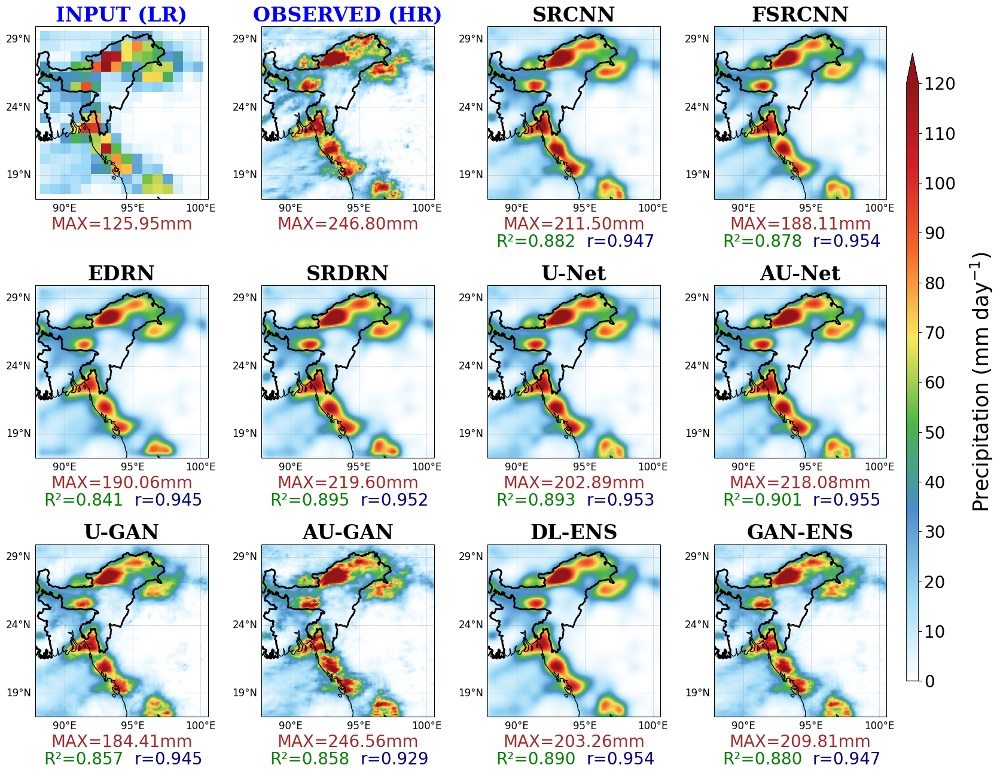

In [6]:

#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

timesteps=[
    ('a', 6763), 
    ]

for snb, timestep in timesteps:

    exp_dict =  {
        'INP': 'INPUT (LR)',
        'REF': 'OBSERVED (HR)',
        'E01_M00': 'SRCNN',
        'E01_M01': 'FSRCNN',
        'E01_M02': 'EDRN',
        'E01_M03': 'SRDRN',
        'E01_M04': 'U-Net',
        'E01_M05': 'AU-Net',
        'E01_M07': 'U-GAN',
        'E01_M08': 'AU-GAN',
        'E01_END': 'DL-ENS',
        'E01_ENG': 'GAN-ENS',
        
    }
    
    # Load datafiles
    DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/PLTDATA/FM03_RandomSamples"
    d = xr.open_dataset(f'{DPATH}/C01_RANDOMDAY_t{timestep}.nc')
    m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/UTILITY/MASKFILES/MASK_C01_SM.nc')
    
    
    # Create axes for subplots and set lonlat limits
    fig, axes = create_shared_axes(nrows=3, ncols=4, figsize=(20, 15), hspace=None, wspace=None)
    
    lon_l, lat_l = (88, 100.5, 3), (18, 31, 3)
    cbar_label = r'Precipitation (mm day$^{-1}$)'
    
    cmap = cmaps.WhiteBlueGreenYellowRed
    vmin, vmax, inc = 0, 120, 10
    
    for i, (data_id, title) in enumerate(exp_dict.items()):
        if i in [18, 19]:
            axes[i].axis('off')
        else:
            my_var = f'{data_id}'.replace(" ", "")
            # ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
            ds_f = d[my_var].squeeze()
            im = my_custom_subplot(ax=axes[i], 
                            ds=ds_f,
                            lonlat=get_lon_lat(d, my_var), 
                            cmap=cmap, vmin=vmin, vmax=vmax, 
                            ylabel=None,
                            title=title,
                            overlay_pval=False,
                            pval_data = None, #d[f'{exp_id}_TSTAT_PVAL'],
                            )

            # # Slanted arrow: bottom-left pointing upward and left (upside down and longer tail)
            # axes[i].annotate(
            #     '', 
            #     xy=(97.5, 18.5),      # arrow head (bottom-left)
            #     xytext=(99.5, 21.0),  # arrow tail (top-right, longer)
            #     arrowprops=dict(arrowstyle="-|>", color='red', lw=2),
            #     annotation_clip=False
            # )
    # -----------------------------
    # Give the date as the heading
    # -----------------------------
    
    start_date = datetime(2001, 1, 1)
    end_date = datetime(2023, 12, 31)
    
    date_list = []
    current_date = start_date
    while current_date <= end_date:
        # date_list now contains all dates as strings in DD-MM-YYYY format
        date_list.append(current_date.strftime("%d-%m-%Y"))
        current_date += timedelta(days=1)
    
    # fig.suptitle(f"Snapshot on {date_list[timestep]}", fontsize=32, fontfamily='serif', fontweight='normal', y=0.95)
    
    #----------------------------------------------------
    # Uncomment below code snippet to set vertical cbar 
    #----------------------------------------------------
    
    # Adjust subplot params so there is space on the right
    fig.subplots_adjust(hspace=0.5, right=0.85)  # example: increase hspace to 0.4
    
    # fig.text(0.1, 0.95, snb, fontsize=36, fontweight='bold', va='top', ha='left')
    
    
    # Add vertical colorbar axis on the right side
    cbar_ax = fig.add_axes([0.86, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
    
    cb = fig.colorbar(im, cax=cbar_ax, 
                      ticks=np.arange(vmin, vmax+inc, inc), 
                      orientation='vertical', 
                      extend='max')
    
    cb.ax.tick_params(labelsize=20)
    cb.set_label(cbar_label, fontsize=25, fontweight='normal', rotation=90, labelpad=15)
    
    # #----------------------------------------------------
    # # Uncomment below code snippet to set horizontal cbar 
    # #----------------------------------------------------
    
    # fig.subplots_adjust(bottom=0.05)
    # cbar_ax = fig.add_axes([0.25, 0.002, 0.5, 0.02])
    # cb = fig.colorbar(im, cax=cbar_ax, 
    #                   ticks=np.arange(vmin, vmax+inc, inc), 
    #                   orientation="horizontal", 
    #                   extend='max')
    # cb.ax.tick_params(labelsize=17)
    # cb.set_label(cbar_label, 
    #              rotation = 0, 
    #              fontsize = 17, 
    #              fontweight='normal') 
    
    SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/RESULTS'
    # plt.savefig(f'{SAVE_DIR}/Figure03_t{timestep:04d}.jpg', format='jpg', dpi=500, bbox_inches='tight',facecolor='w', edgecolor='w')
    plt.show()

## Supplementary Figures

In [14]:
timesteps = indices_above_percentile(ds, 99.89)
print(len(timesteps))
timesteps

10


array([ 566,  567, 1235, 1287, 1376, 2392, 3568, 6371, 6765, 7967])

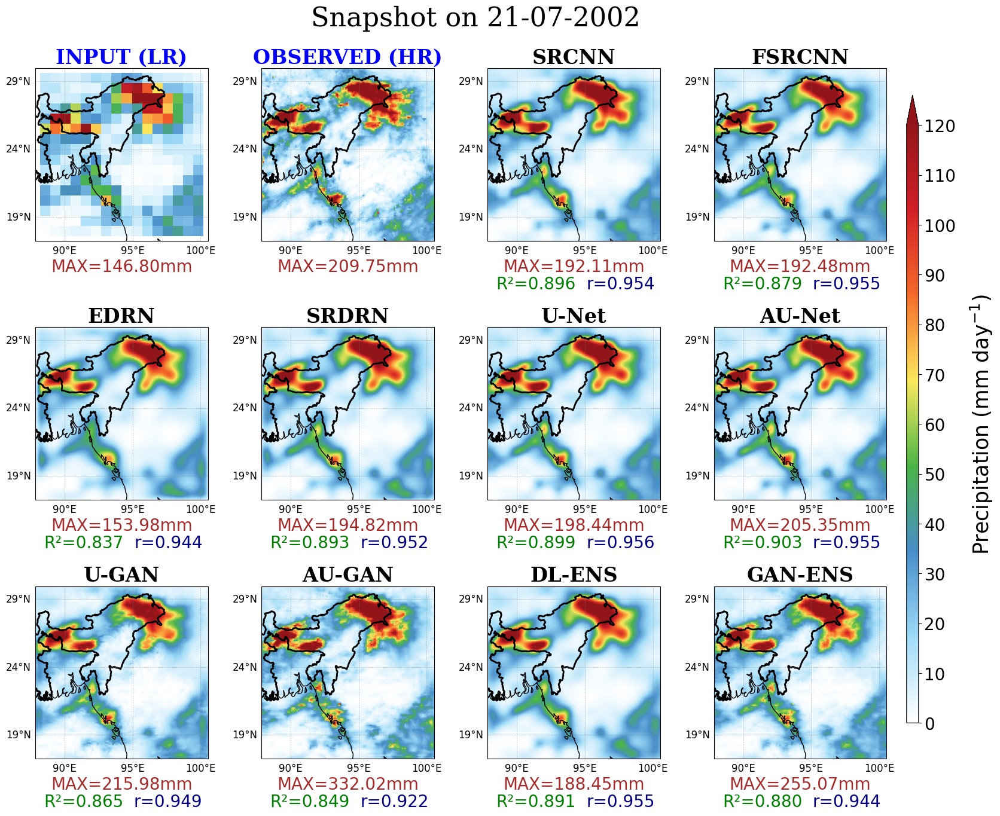

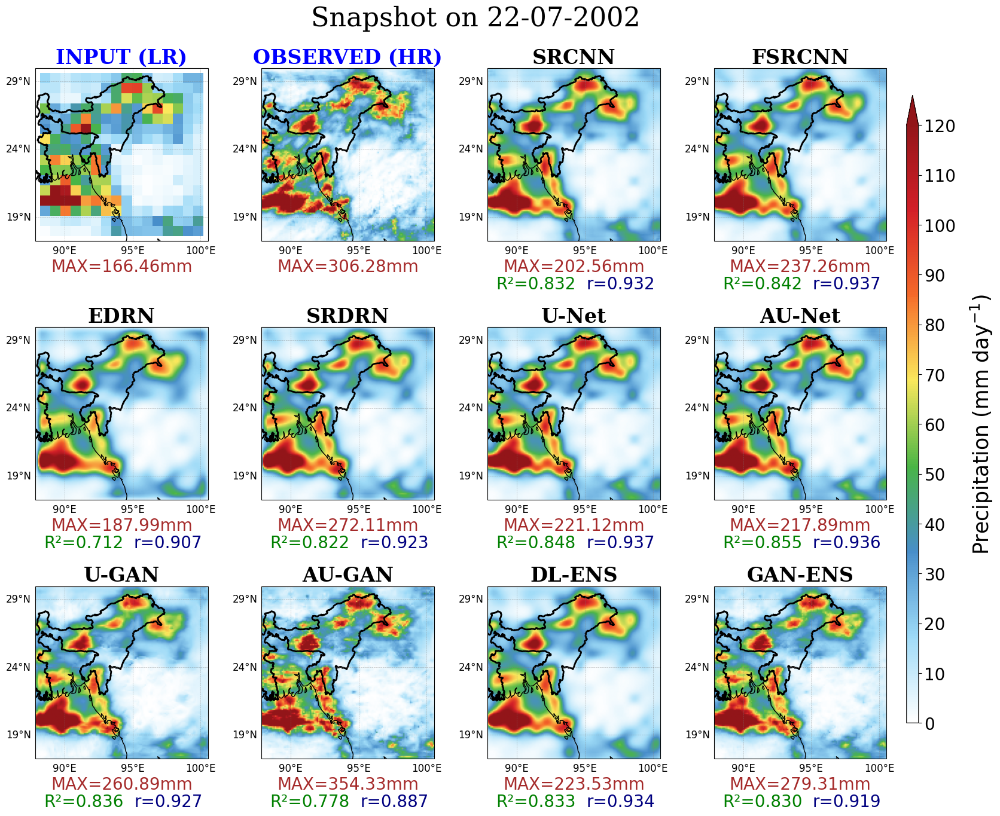

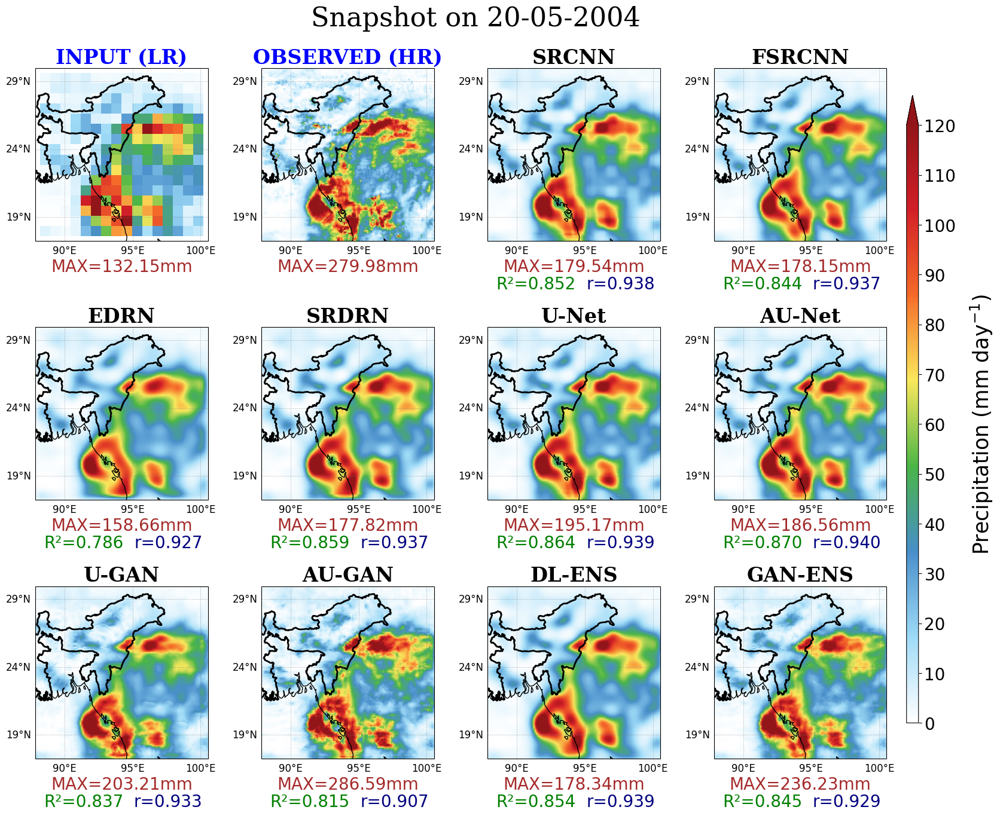

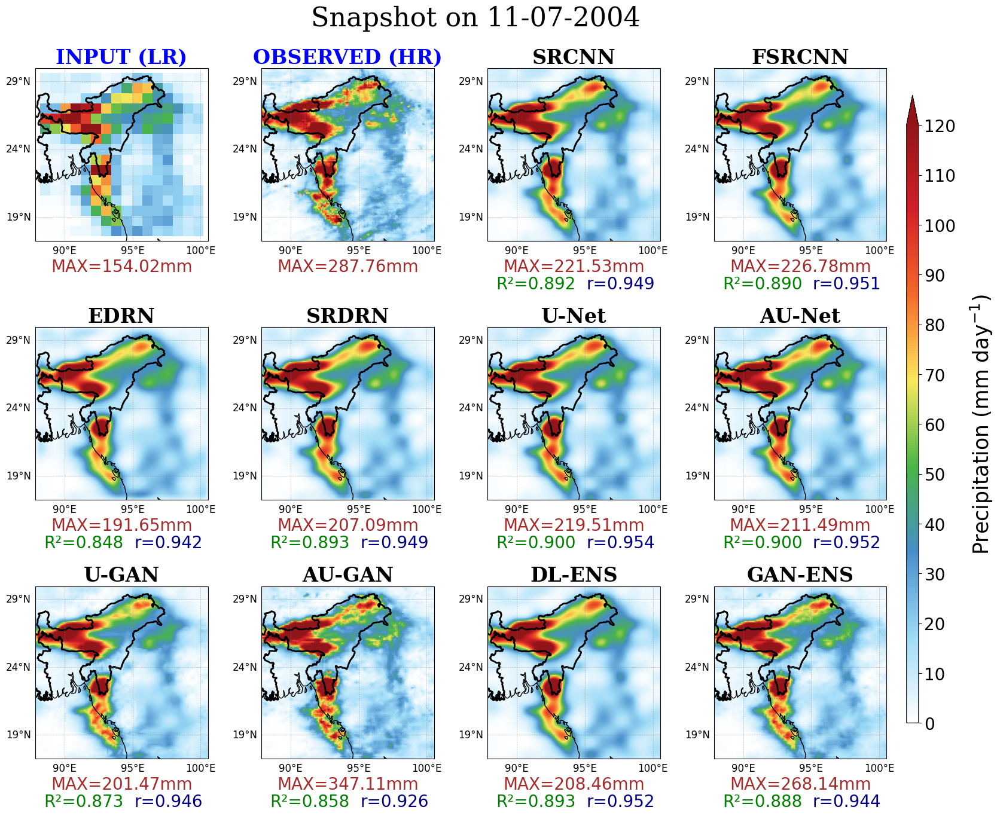

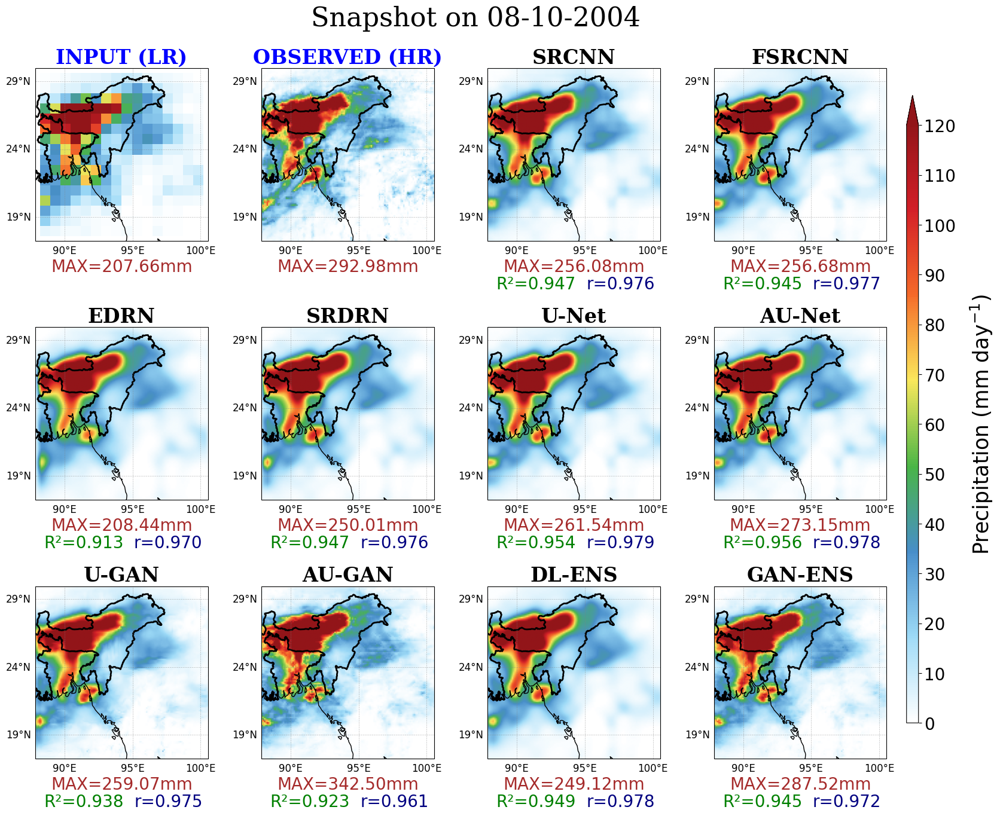

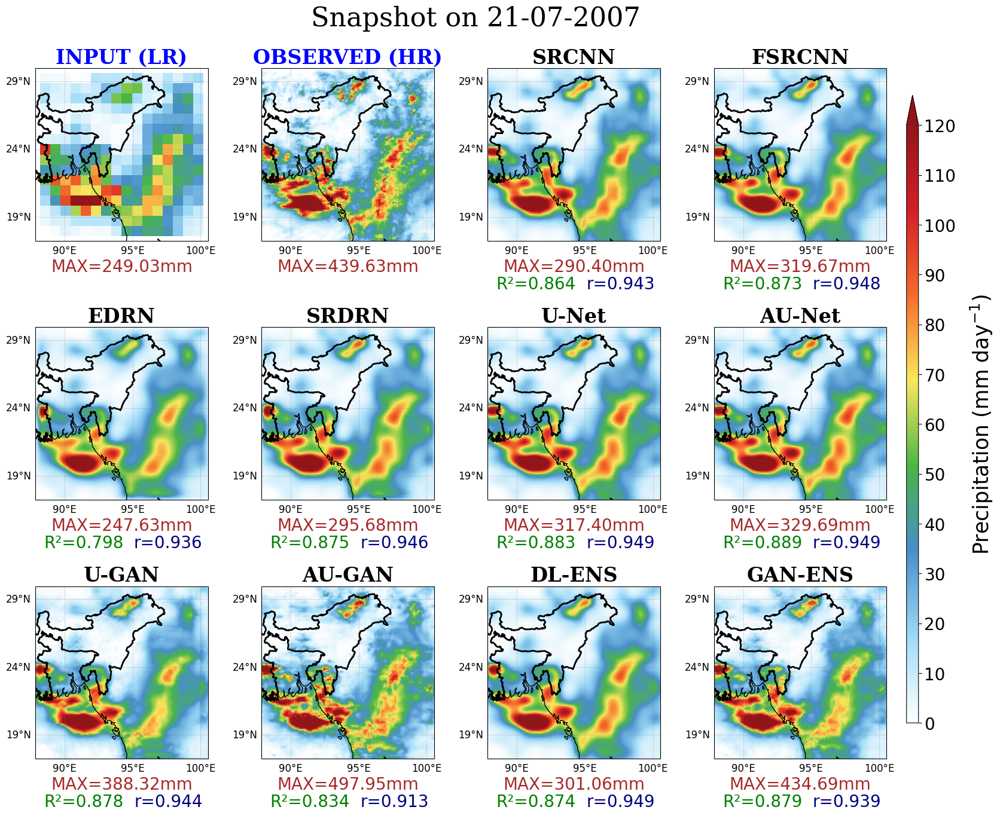

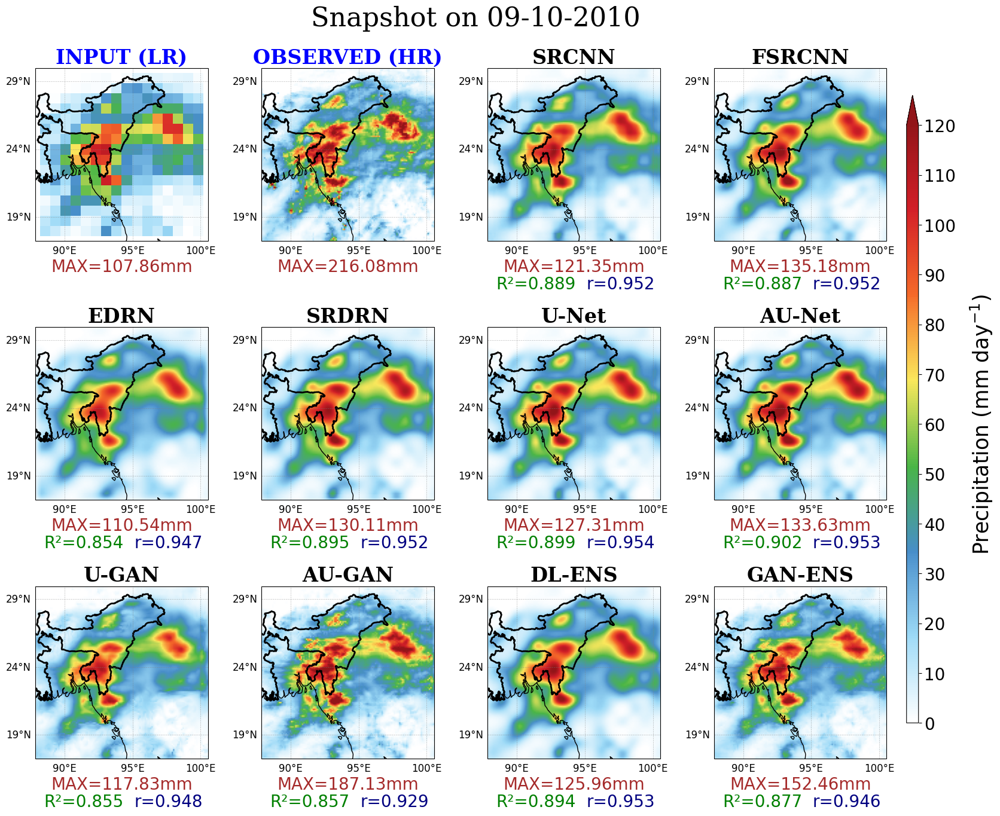

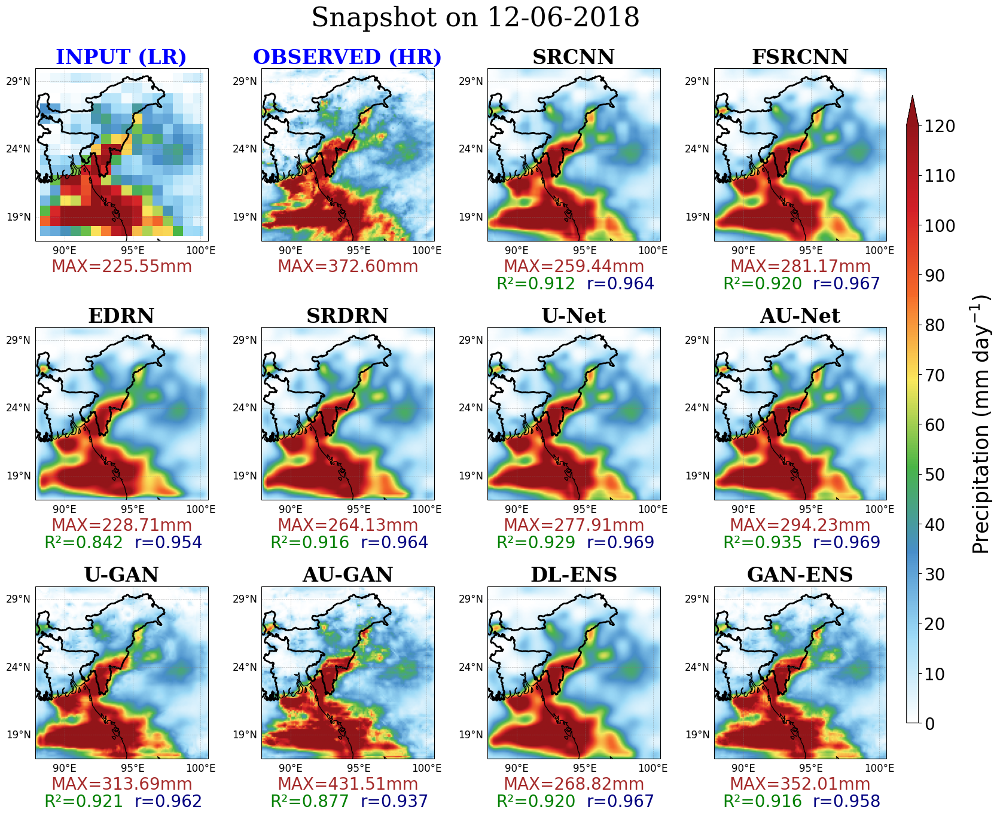

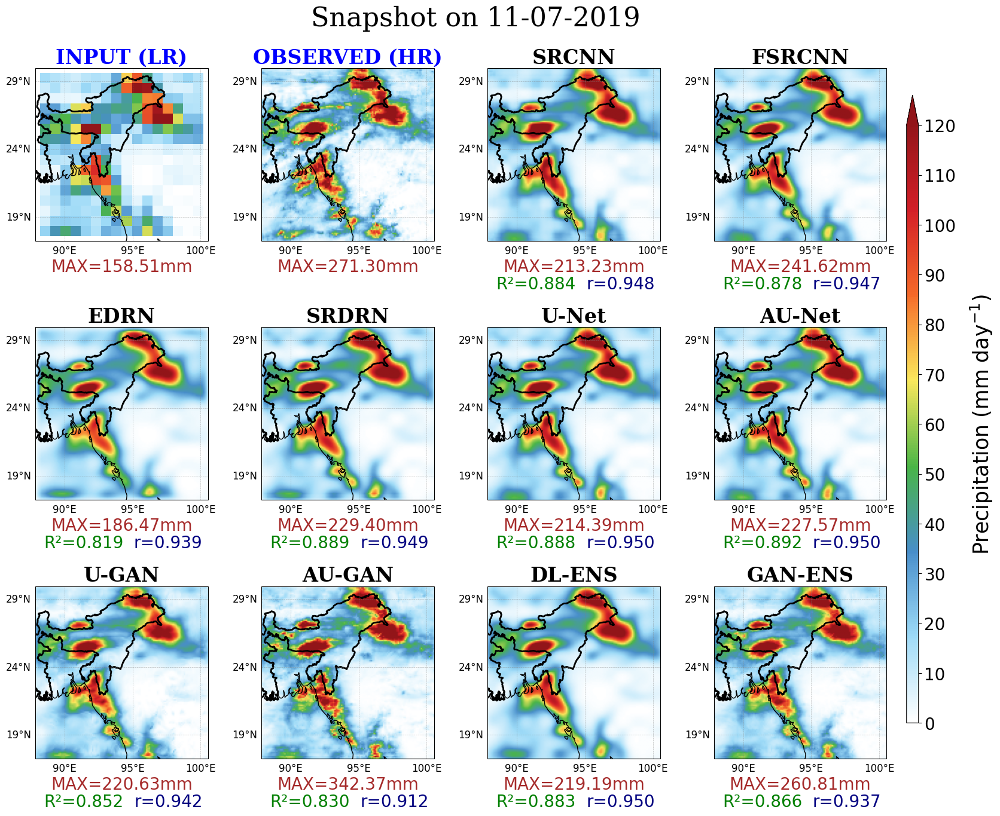

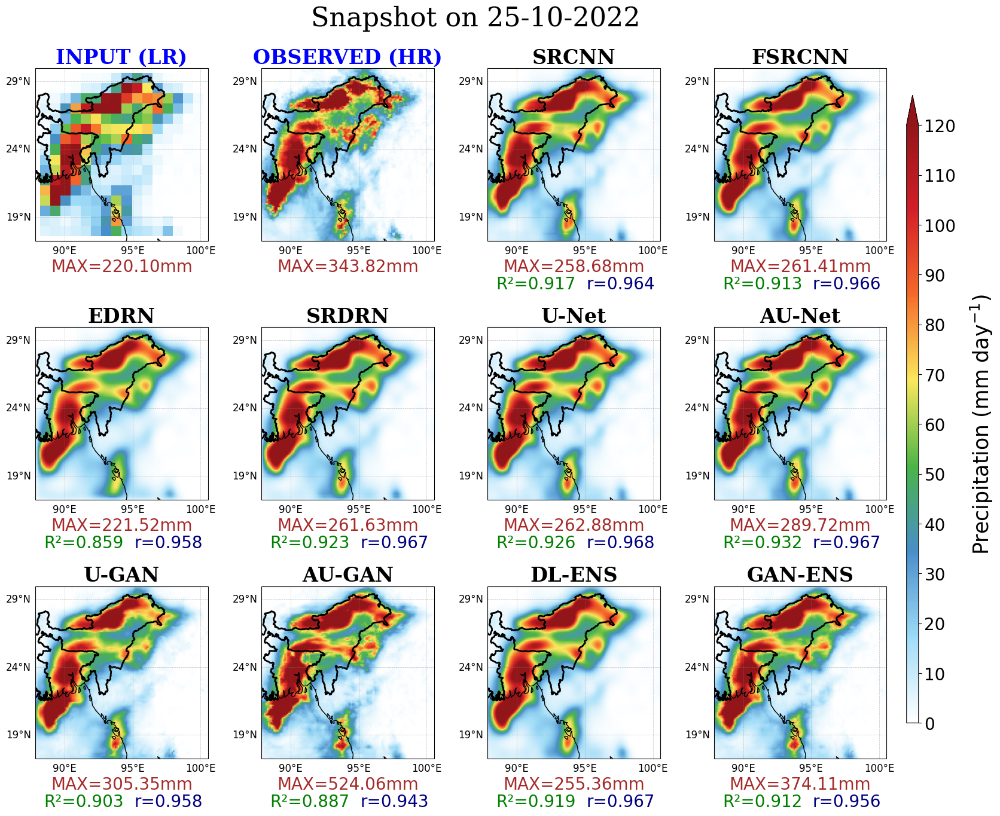

In [55]:

#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

## Load the FLDMEAN data
import xarray as xr
ds = xr.open_dataset("/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/PLTDATA/FM03_RandomSamples/CO1_SM_FLDMEAN_2001-2023.nc").prec.data.squeeze()

timesteps = indices_above_percentile(ds, 99.89)

for timestep in timesteps:

    exp_dict =  {
        'INP': 'INPUT (LR)',
        'REF': 'OBSERVED (HR)',
        'E01_M00': 'SRCNN',
        'E01_M01': 'FSRCNN',
        'E01_M02': 'EDRN',
        'E01_M03': 'SRDRN',
        'E01_M04': 'U-Net',
        'E01_M05': 'AU-Net',
        'E01_M07': 'U-GAN',
        'E01_M08': 'AU-GAN',
        'E01_END': 'DL-ENS',
        'E01_ENG': 'GAN-ENS',
        
    }
    
    # Load datafiles
    DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/PLTDATA/FM03_RandomSamples"
    d = xr.open_dataset(f'{DPATH}/C01_RANDOMDAY_t{timestep}.nc')
    m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/UTILITY/MASKFILES/MASK_C01_SM.nc')
    
    
    # Create axes for subplots and set lonlat limits
    fig, axes = create_shared_axes(nrows=3, ncols=4, figsize=(20, 15), hspace=None, wspace=None)
    
    lon_l, lat_l = (88, 100.5, 3), (18, 31, 3)
    cbar_label = r'Precipitation (mm day$^{-1}$)'
    
    cmap = cmaps.WhiteBlueGreenYellowRed
    vmin, vmax, inc = 0, 120, 10
    
    for i, (data_id, title) in enumerate(exp_dict.items()):
        if i in [18, 19]:
            axes[i].axis('off')
        else:
            my_var = f'{data_id}'.replace(" ", "")
            # ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
            ds_f = d[my_var].squeeze()
            im = my_custom_subplot(ax=axes[i], 
                            ds=ds_f,
                            lonlat=get_lon_lat(d, my_var), 
                            cmap=cmap, vmin=vmin, vmax=vmax, 
                            text=None, #f"R² = {round(r2_score(ds_f.data.flatten(), d['REF'].data.flatten()), 3)}" if not data_id in ['INP', 'REF'] else None,
                            text_loc=None, #[0.5, -0.25],
                            ylabel=None,
                            title=title,
                            overlay_pval=False,
                            pval_data = None, #d[f'{exp_id}_TSTAT_PVAL'],
                            )
    
    # -----------------------------
    # Give the date as the heading
    # -----------------------------
    
    start_date = datetime(2001, 1, 1)
    end_date = datetime(2023, 12, 31)
    
    date_list = []
    current_date = start_date
    while current_date <= end_date:
        # date_list now contains all dates as strings in DD-MM-YYYY format
        date_list.append(current_date.strftime("%d-%m-%Y"))
        current_date += timedelta(days=1)
    
    fig.suptitle(f"Snapshot on {date_list[timestep]}", fontsize=32, fontfamily='serif', fontweight='normal', y=0.95)
    
    #----------------------------------------------------
    # Uncomment below code snippet to set vertical cbar 
    #----------------------------------------------------
    
    # Adjust subplot params so there is space on the right
    fig.subplots_adjust(hspace=0.5, right=0.85)  # example: increase hspace to 0.4
    
    # fig.text(0.1, 0.95, snb, fontsize=36, fontweight='bold', va='top', ha='left')
    
    
    # Add vertical colorbar axis on the right side
    cbar_ax = fig.add_axes([0.86, 0.15, 0.01, 0.7])  # [left, bottom, width, height]
    
    cb = fig.colorbar(im, cax=cbar_ax, 
                      ticks=np.arange(vmin, vmax+inc, inc), 
                      orientation='vertical', 
                      extend='max')
    
    cb.ax.tick_params(labelsize=20)
    cb.set_label(cbar_label, fontsize=25, fontweight='normal', rotation=90, labelpad=15)
    
    # #----------------------------------------------------
    # # Uncomment below code snippet to set horizontal cbar 
    # #----------------------------------------------------
    
    # fig.subplots_adjust(bottom=0.05)
    # cbar_ax = fig.add_axes([0.25, 0.002, 0.5, 0.02])
    # cb = fig.colorbar(im, cax=cbar_ax, 
    #                   ticks=np.arange(vmin, vmax+inc, inc), 
    #                   orientation="horizontal", 
    #                   extend='max')
    # cb.ax.tick_params(labelsize=17)
    # cb.set_label(cbar_label, 
    #              rotation = 0, 
    #              fontsize = 17, 
    #              fontweight='normal') 
    
    SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P02A_DeepDown_Generalization/ANALYSE/RESULTS'
    plt.savefig(f'{SAVE_DIR}/FigureSX_t{timestep:04d}.jpg', format='jpg', dpi=500, bbox_inches='tight',facecolor='w', edgecolor='w')
    plt.show()